**Overview**

This document describes the implementation of an optimized inference pipeline for processing long-duration videos to detect and track children and therapists. The pipeline leverages state-of-the-art open-source models for object detection, feature extraction, and tracking to deliver accurate bounding boxes and unique IDs.


**Objectives**

- Object Detection: Detect children and therapists in video frames.
- Tracking: Track objects across frames and assign unique IDs.
- Output: Display and save video with bounding boxes and unique IDs overlaid.

**Components**

1. Object Detection: YOLOv8

2. Re-identification: OSNet

3. Tracking: DeepSORT

4. Video Processing: OpenCV

**INDEX**

1.**Import Libraries**


2.**Data Preparation**

- Dataset Collection

   - Using Roboflow
- Dataset Details

    - data.yaml Configuration
3.**Model Training**
  - Training YOLOv8

      - Training Command

      - Training Results

  - Model Evaluation

     - Validation

    - Example Results

4.**Model Inference**

     - Prediction Command
     - Displaying Predictions
5.**Additional Tools**

   - Video Download

   - Using yt-dlp

- Code for Video Download

6.**References**

- Model and Data References
- Additional Resources





In [ ]:
!nvidia-smi

Thu Sep  5 05:58:43 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   56C    P8              10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.8/41.8 kB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 872.1/872.1 kB 18.7 MB/s eta 0:00:00


In [ ]:
!pip install --upgrade ultralytics


In [ ]:
from ultralytics import YOLO
import os
from IPython.display import display, Image
from IPython import display
display.clear_output()
!yolo mode=checks

Traceback (most recent call last):
  File "/usr/local/bin/yolo", line 8, in <module>
    sys.exit(entrypoint())
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/cfg/__init__.py", line 771, in entrypoint
    raise ValueError(f"Invalid 'mode={mode}'. Valid modes are {MODES}.\n{CLI_HELP_MSG}")
ValueError: Invalid 'mode=<module 'ultralytics.utils.checks' from '/usr/local/lib/python3.10/dist-packages/ultralytics/utils/checks.py'>'. Valid modes are {'export', 'benchmark', 'track', 'train', 'val', 'predict'}.

    Arguments received: ['yolo', 'mode=checks']. Ultralytics 'yolo' commands use the following syntax:

        yolo TASK MODE ARGS

        Where   TASK (optional) is one of {'pose', 'segment', 'classify', 'obb', 'detect'}
                MODE (required) is one of {'export', 'benchmark', 'track', 'train', 'val', 'predict'}
                ARGS (optional) are any number of custom 'arg=value' pairs like 'imgsz=320' that override defaults.
                    See all ARGS at ht

2. **Data Preparation**

- Dataset Collection

- Using Roboflow

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="7ZGgFdBHK9SJdpR2FrVG")
project = rf.workspace("aniruddha-jmp5a").project("child-adult-detection-u81pm")
version = project.version(1)
dataset = version.download("yolov8")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 kB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 5.0 MB/s eta 0:00:00
  Attempting uninstall: idna
    Found existing installation: idna 3.8
    Uninstalling idna-3.8:
      Successfully uninstalled idna-3.8
loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.2.87, to fix: `pip install ultralytics==8.0.196`



Extracting Dataset Version Zip to Child-Adult-Detection-1 in yolov8:: 100%|██████████| 2994/2994 [00:00<00:00, 5380.25it/s]


3. **Model Training**

In [ ]:
!yolo detect train model=yolov8l.pt data=/content/Child-Adult-Detection-1/data.yaml epochs=50 imgsz=640


Ultralytics YOLOv8.2.87 🚀 Python-3.10.12 torch-2.4.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8l.pt, data=/content/Child-Adult-Detection-1/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show

4. **Model Inference**

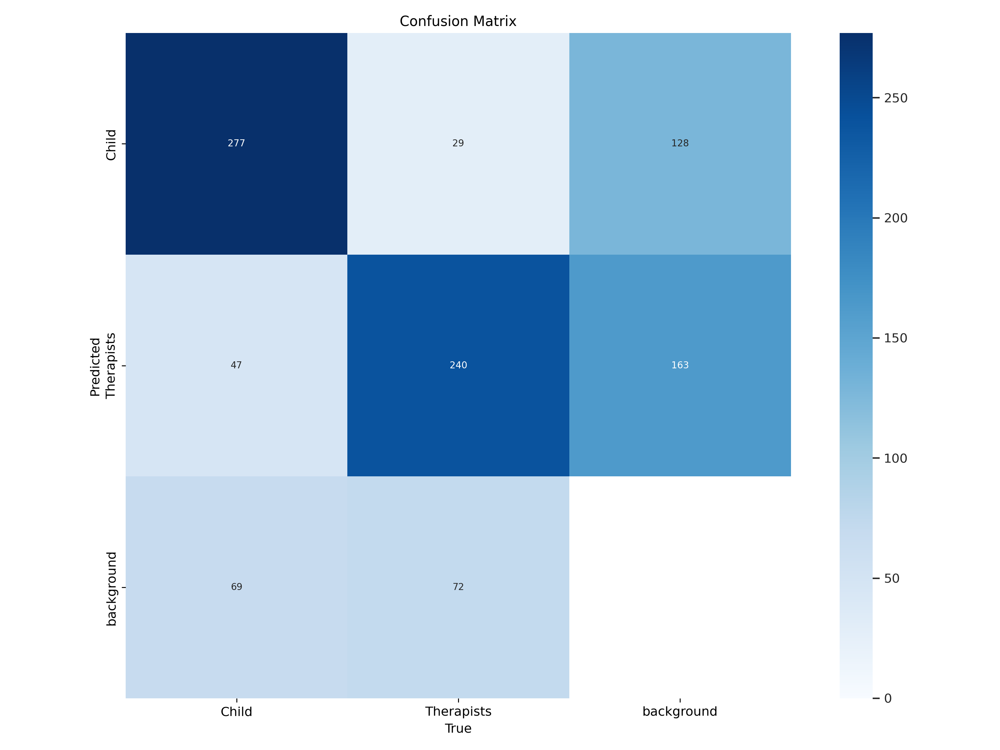

In [ ]:
Image(filename=f'/content/runs/detect/train2/confusion_matrix.png',width=600)

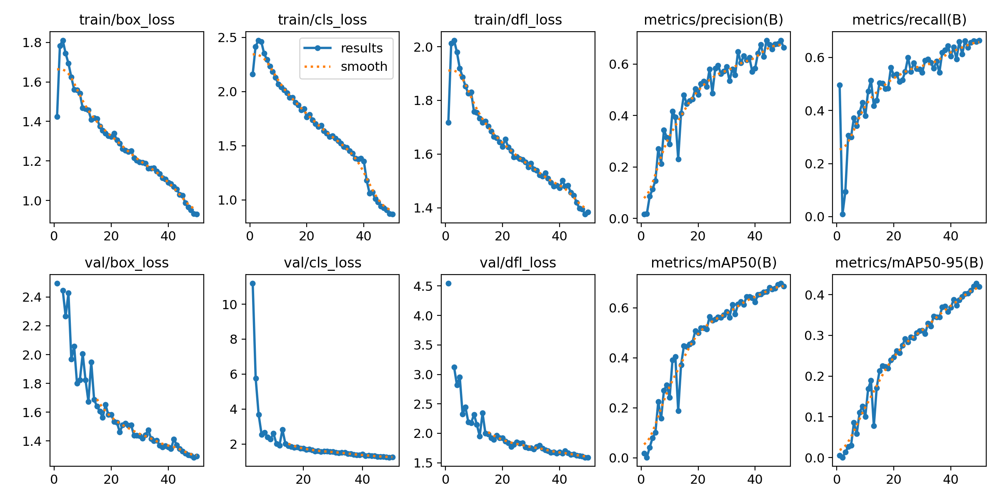

In [ ]:
Image(filename=f'/content/runs/detect/train2/results.png', width=600)

In [ ]:
!yolo task=detect mode=val model=/content/runs/detect/train2/weights/best.pt data=/content/Child-Adult-Detection-1/data.yaml

Ultralytics YOLOv8.2.87 🚀 Python-3.10.12 torch-2.4.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 268 layers, 43,608,150 parameters, 0 gradients, 164.8 GFLOPs
val: Scanning /content/Child-Adult-Detection-1/valid/labels.cache... 305 images, 0 backgrounds, 0 corrupt: 100% 305/305 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 20/20 [00:15<00:00,  1.33it/s]
                   all        305        734      0.695       0.66      0.697      0.428
                 Child        284        393      0.741      0.664      0.738      0.465
            Therapists        201        341      0.649      0.656      0.657      0.391
Speed: 0.8ms preprocess, 34.7ms inference, 0.1ms loss, 6.1ms postprocess per image
Results saved to runs/detect/val
💡 Learn more at https://docs.ultralytics.com/modes/val


In [ ]:
!yolo task=detect mode=predict model=/content/runs/detect/train2/weights/best.pt conf=0.5 source=/content/Child-Adult-Detection-1/test/images

Ultralytics YOLOv8.2.87 🚀 Python-3.10.12 torch-2.4.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 268 layers, 43,608,150 parameters, 0 gradients, 164.8 GFLOPs

image 1/147 /content/Child-Adult-Detection-1/test/images/000000000192_jpg.rf.f6596801c692d504184bd088e9a84775.jpg: 640x640 1 Child, 2 Therapistss, 61.7ms
image 2/147 /content/Child-Adult-Detection-1/test/images/000000000322_jpg.rf.5ba1a52a090ddf6c2fb56b84409fcd71.jpg: 640x640 1 Therapists, 61.3ms
image 3/147 /content/Child-Adult-Detection-1/test/images/000000000531_jpg.rf.407cdd19cffefd77a9f8823c61dd007a.jpg: 640x640 1 Therapists, 59.2ms
image 4/147 /content/Child-Adult-Detection-1/test/images/10047_jpg.rf.62a4c811f437648393ceda2f0dc4ee6e.jpg: 640x640 1 Therapists, 57.6ms
image 5/147 /content/Child-Adult-Detection-1/test/images/10257_jpg.rf.d3c3ff711b6ecd2d6d2ee2e68368bcfe.jpg: 640x640 1 Therapists, 57.6ms
image 6/147 /content/Child-Adult-Detection-1/test/images/10579_jpg.rf.abe2150d7d6b5aedd5a09eb478934c95.jpg: 640x

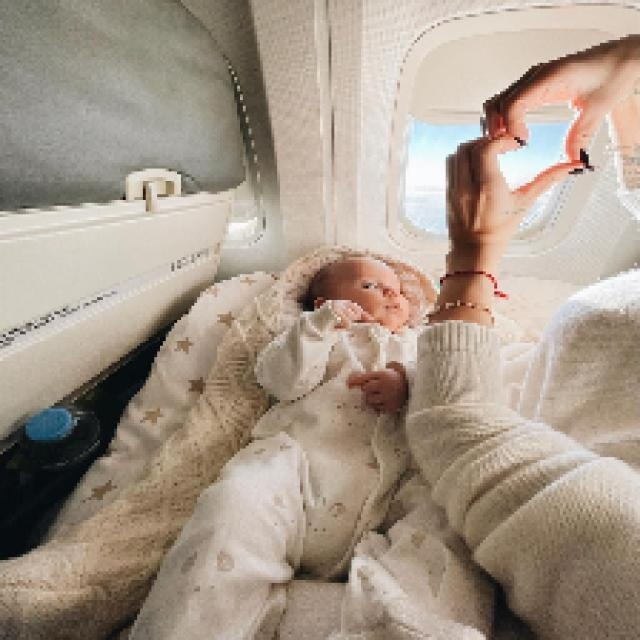

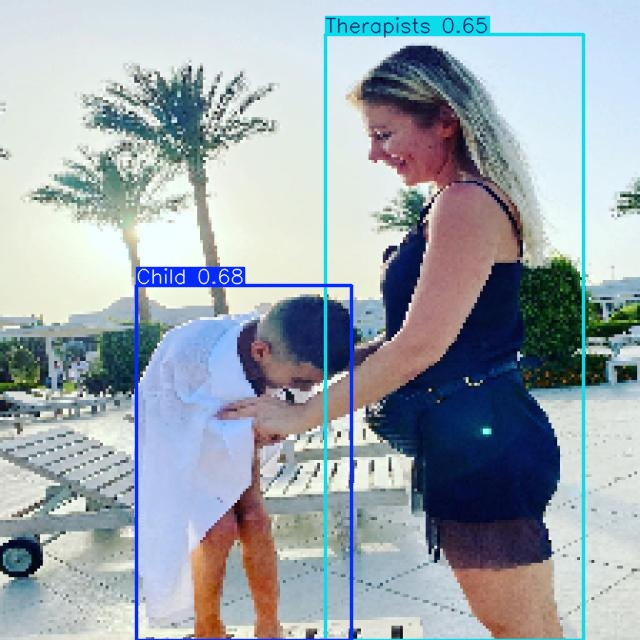

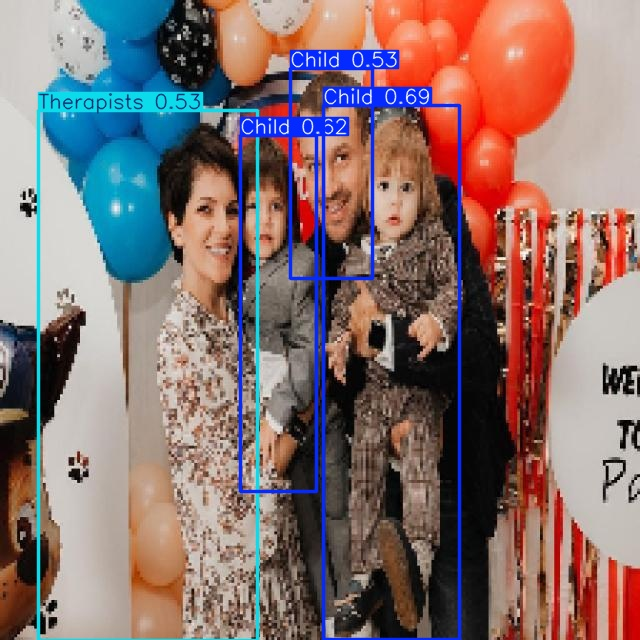

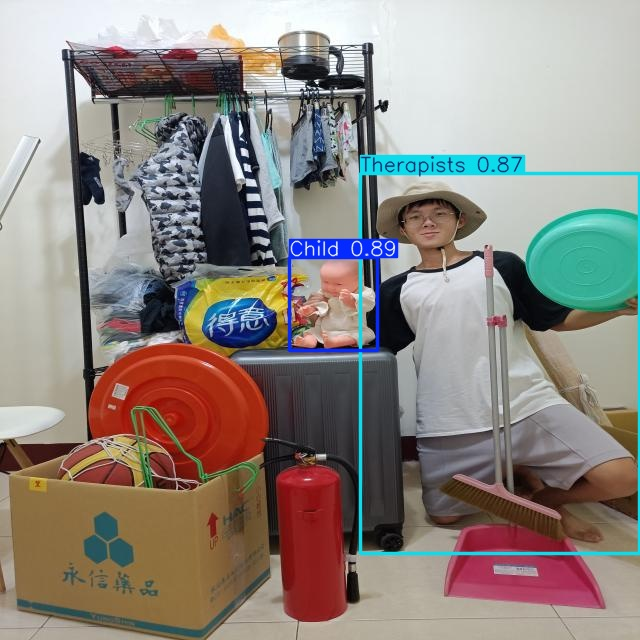

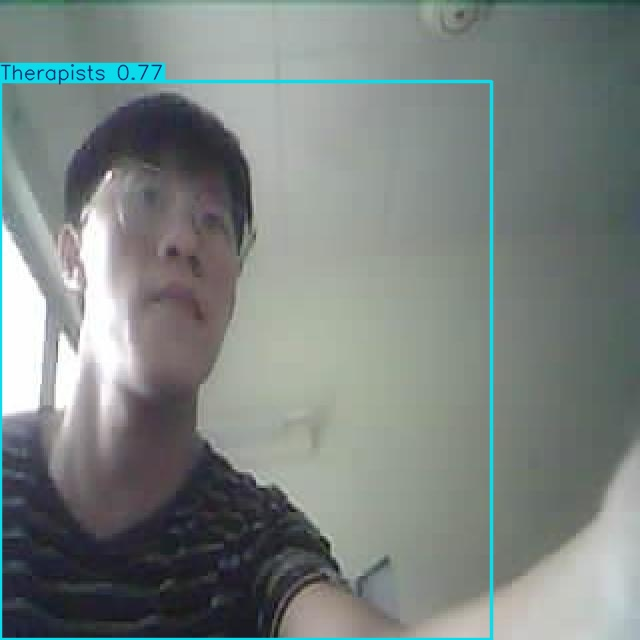

...

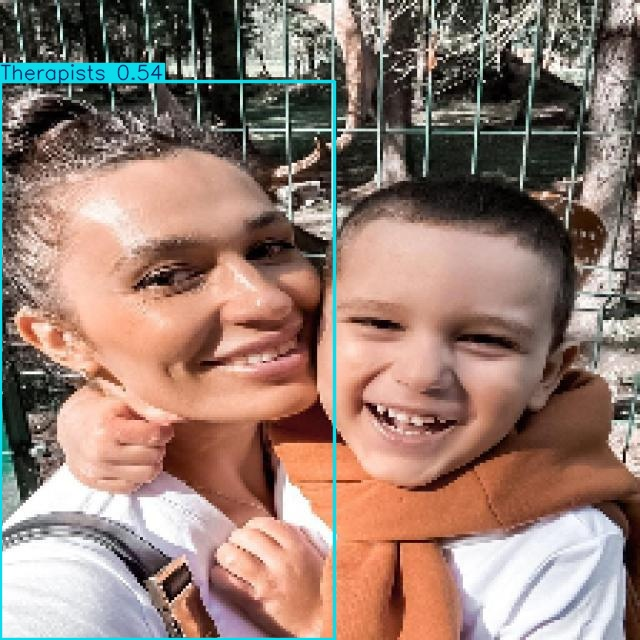

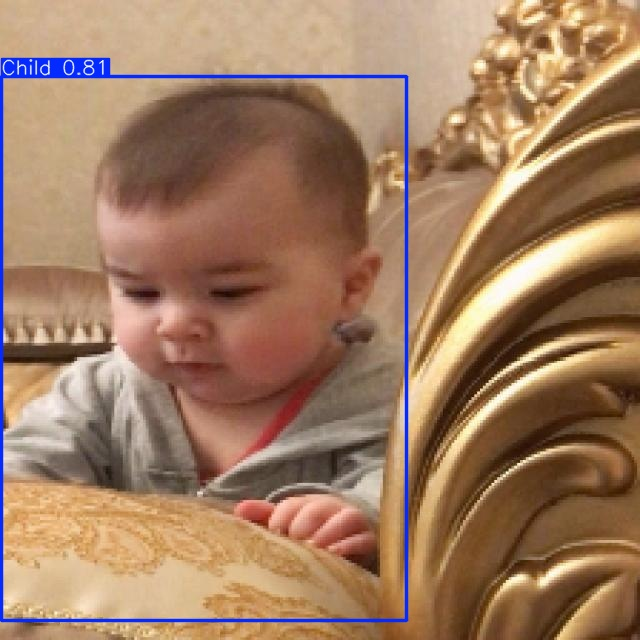

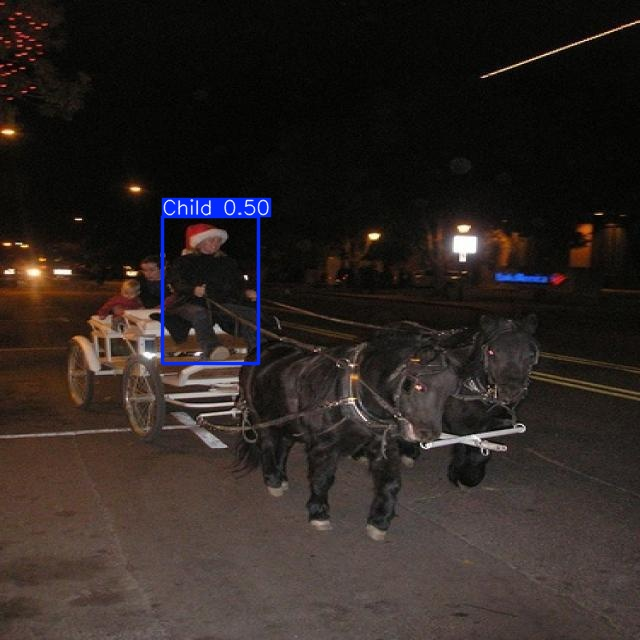

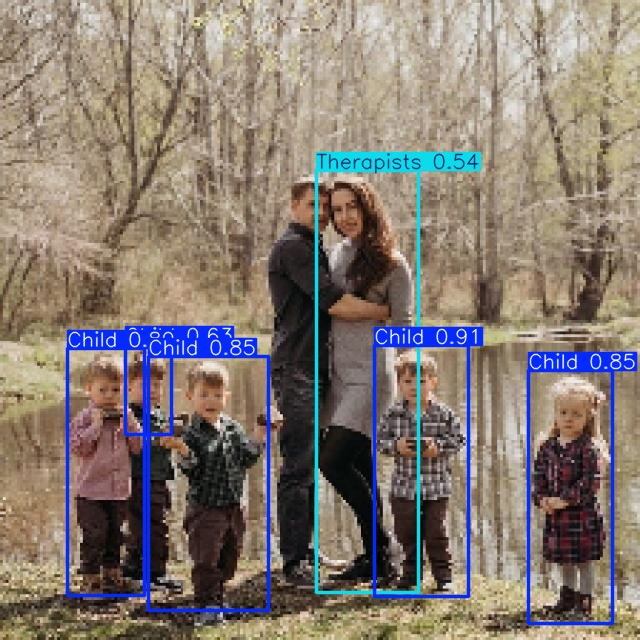

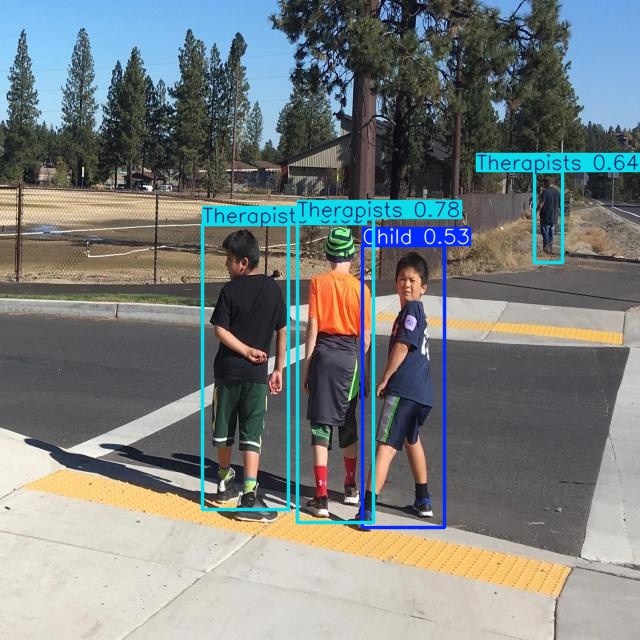

In [ ]:
import glob
from IPython.display import Image, display

for image_path in glob.glob('runs/detect/predict/*.jpg'):
    display(Image(filename=image_path))
    print("\n")
#

**Current Accuracy**

The YOLOv8 model currently achieves 68.5% accuracy in detecting children and therapists. This accuracy level impacts the model’s ability to reliably differentiate between these two classes, leading to potential misidentifications and tracking issues.

In [ ]:
!pip install yt-dlp

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 170.1/170.1 kB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 35.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 157.3/157.3 kB 11.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 76.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.4/194.4 kB 16.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 53.2 MB/s eta 0:00:00


In [ ]:
!yt-dlp https://www.youtube.com/watch?v=3mXFJ8S-boU&t=6s

[youtube] Extracting URL: https://www.youtube.com/watch?v=3mXFJ8S-boU
[youtube] 3mXFJ8S-boU: Downloading webpage
[youtube] 3mXFJ8S-boU: Downloading ios player API JSON
[youtube] 3mXFJ8S-boU: Downloading web creator player API JSON
[youtube] 3mXFJ8S-boU: Downloading player 57c75fa4
[youtube] 3mXFJ8S-boU: Downloading m3u8 information
[info] 3mXFJ8S-boU: Downloading 1 format(s): 248+251
[download] Destination: ＂Helping Preschool Children with Autism： Teachers and Parents as Partners＂ Program Overview XFJ8S-boU].f248.webm
[download] 100% of   85.58MiB in 00:00:01 at 56.68MiB/s
[download] Destination: ＂Helping Preschool Children with Autism： Teachers and Parents as Partners＂ Program Overview XFJ8S-boU].f251.webm
[download] 100% of    4.65MiB in 00:00:00 at 48.15MiB/s
[Merger] Merging formats into "＂Helping Preschool Children with Autism： Teachers and Parents as Partners＂ Program Overview XFJ8S-boU].webm"
Deleting original file ＂Helping Preschool Children with Autism： Teachers and Parents as